# Article `014`

## Sentinel-2 

## DEM

## Sentine-2 

Geo Point
```
Left Top: 139.00331,35.99591
right Bottom: 140.00690,35.15523
```
CRS: `WGS84` 

In [ ]:
!gdalwarp -te 139.00331 35.99591 140.00690 35.15523 -t_srs EPSG:4326 -te_srs EPSG:4326 dem.tif dem_cut.tif

In [ ]:
!gdalwarp -te 139.00331 35.99591 140.00690 35.15523 -t_srs EPSG:4326 -te_srs EPSG:4326 R10m/B02.jp2 R10m/B02_cut.tif

## Processing

In [1]:
import tifffile
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os, random, math
from tqdm.notebook import tqdm

In [2]:
PATH_B2  = '../sample/B02_cut.tif'
PATH_DEM = '../sample/dem_cut.tif'

## Vizualize

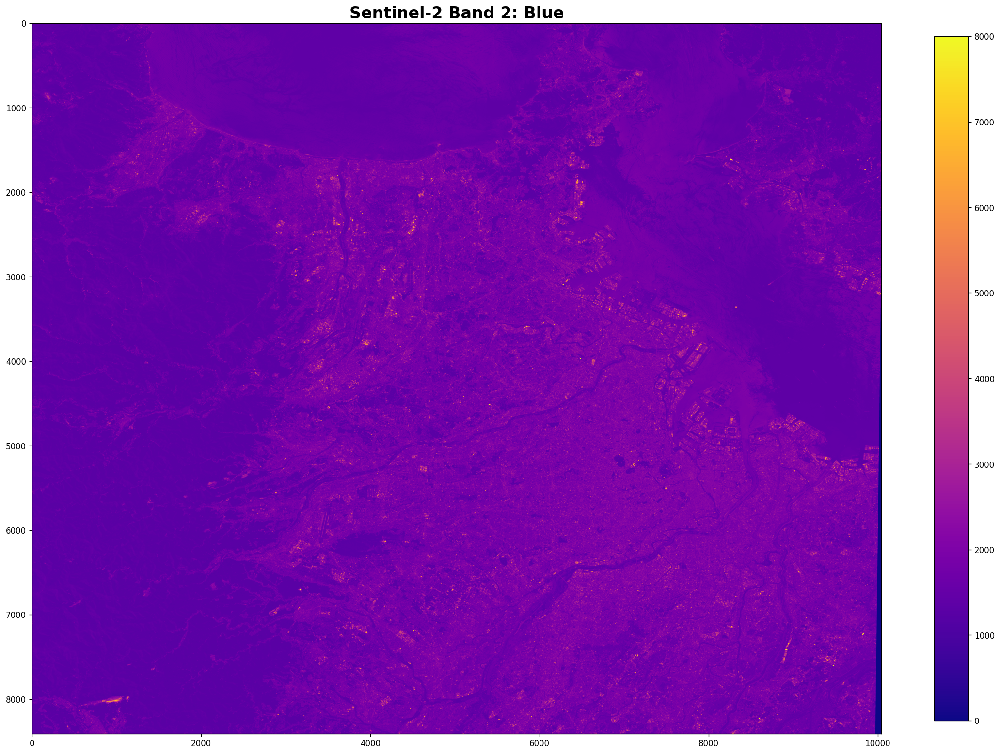

In [3]:
b2 = tifffile.imread(PATH_B2)
b2 = b2.astype(np.float32)

plt.figure(figsize=(19, 16), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 2: Blue', fontsize=20, fontweight='bold')
plt.imshow(b2, cmap='plasma', vmin=0., vmax=8000.)
plt.colorbar(shrink=0.75)
plt.tight_layout()
plt.savefig('../output/b2.png')
plt.show();

plt.clf()
plt.close()

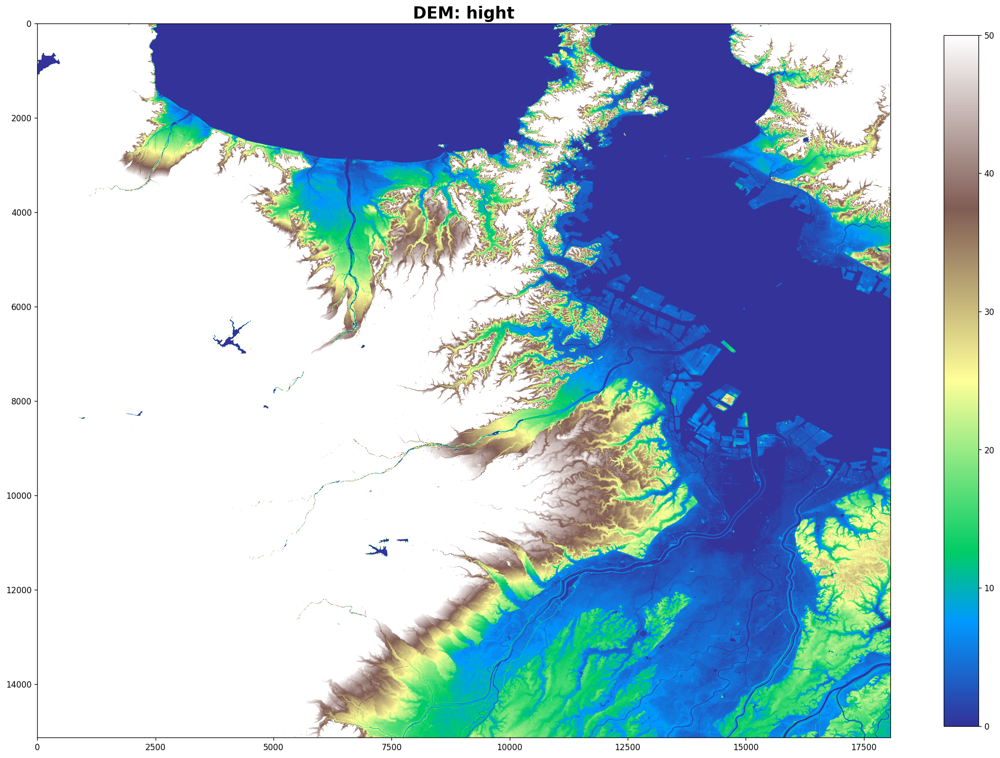

In [4]:
dem = tifffile.imread(PATH_DEM)
dem[np.isnan(dem)] = -1
dem = dem.astype(np.float32)

plt.figure(figsize=(19, 16), dpi=120, facecolor='w', edgecolor='k')
plt.title('DEM: hight', fontsize=20, fontweight='bold')
plt.imshow(dem, cmap='terrain', vmin=0., vmax=50.)
plt.colorbar(shrink=0.75)
plt.tight_layout()
plt.savefig('../output/dem.png')
plt.show();

plt.clf()
plt.close()

In [5]:
b2.shape, dem.shape

((8412, 10042), (15132, 18065))

In [6]:
dem = cv2.resize(dem, (b2.shape[1], b2.shape[0]), interpolation=cv2.INTER_LINEAR)
dem.shape

(8412, 10042)

In [7]:
tifffile.imwrite('../output/dem_resize_gt.tif', dem)

## Ground Mask

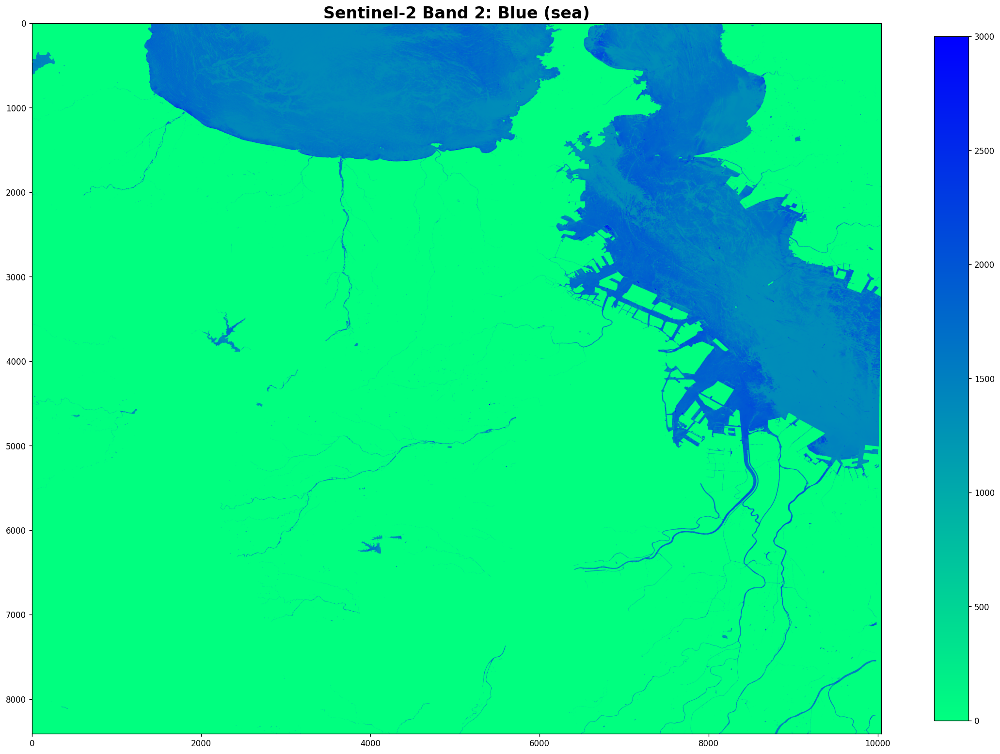

In [8]:
b2_sea = np.where(dem == -1, b2, 0)

plt.figure(figsize=(19, 16), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 2: Blue (sea)', fontsize=20, fontweight='bold')
plt.imshow(b2_sea, cmap='winter_r', vmin=0., vmax=3000.)
plt.colorbar(shrink=0.75,)
plt.tight_layout()
plt.savefig('../output/b2_sea.png')
plt.show();

plt.clf()
plt.close()

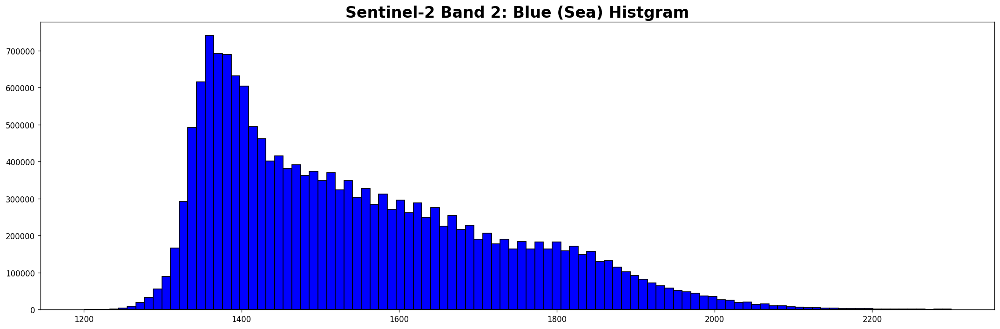

In [9]:
plt.figure(figsize=(18, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 2: Blue (Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(b2_sea[b2_sea > 1].ravel(), bins=100, range=(1200., 2300.), fc='b', ec='k')
plt.tight_layout()
plt.savefig('../output/b2_sea_hist.png')
plt.show();

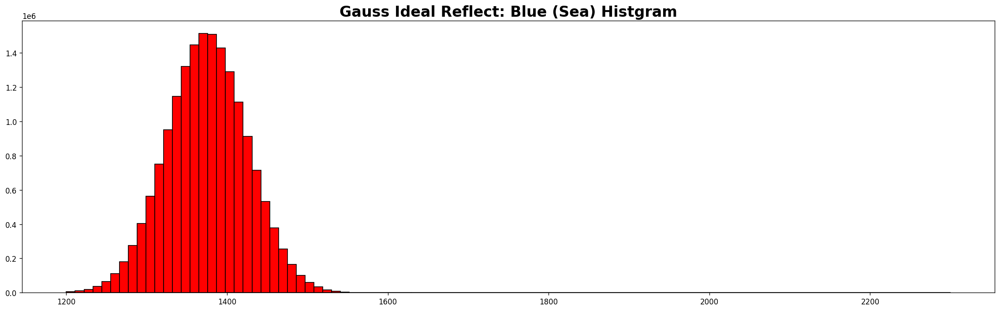

In [10]:
gauss_sea = np.random.normal(loc=1375, scale=50 , size=(len(b2_sea[b2_sea > 1])))

plt.figure(figsize=(19, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Gauss Ideal Reflect: Blue (Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(gauss_sea.ravel(), bins=100, range=(1200., 2300.), fc='r', ec='k')
plt.tight_layout()
plt.savefig('../output/gauss_sea_hist.png')
plt.show();

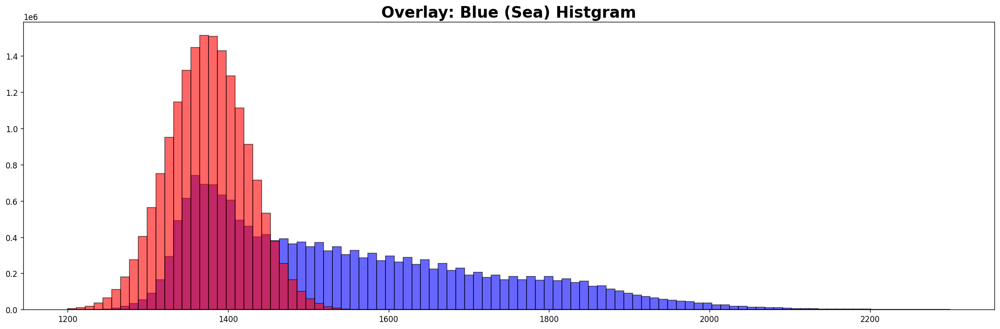

In [11]:
plt.figure(figsize=(18, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Overlay: Blue (Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(b2_sea[b2_sea > 1].ravel(), bins=100, range=(1200., 2300.), fc='b', ec='k', alpha=0.6)
plt.hist(gauss_sea.ravel(), bins=100, range=(1200., 2300.), fc='r', ec='k', alpha=0.6)
plt.tight_layout()
plt.savefig('../output/sea_overlay_hist.png')
plt.show();

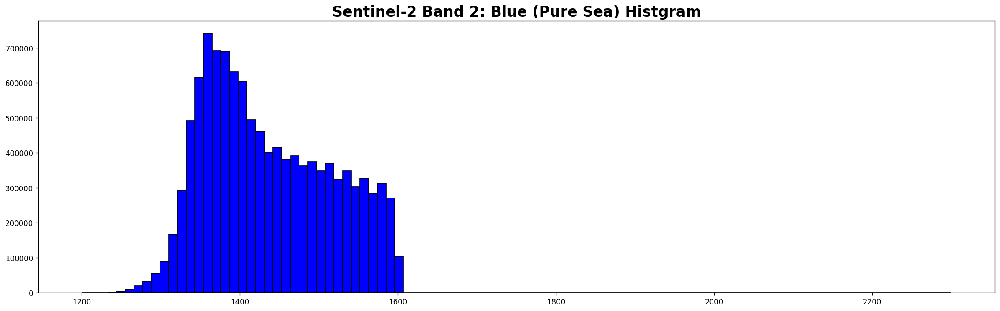

In [12]:
b2_sea_points = b2_sea[b2_sea > 1]
b2_sea_points = b2_sea_points[b2_sea_points < 1600]

plt.figure(figsize=(19, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 2: Blue (Pure Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(b2_sea_points, bins=100, range=(1200., 2300.), fc='b', ec='k')
plt.tight_layout()
plt.savefig('../output/b2_sea_pure_hist.png')
plt.show();

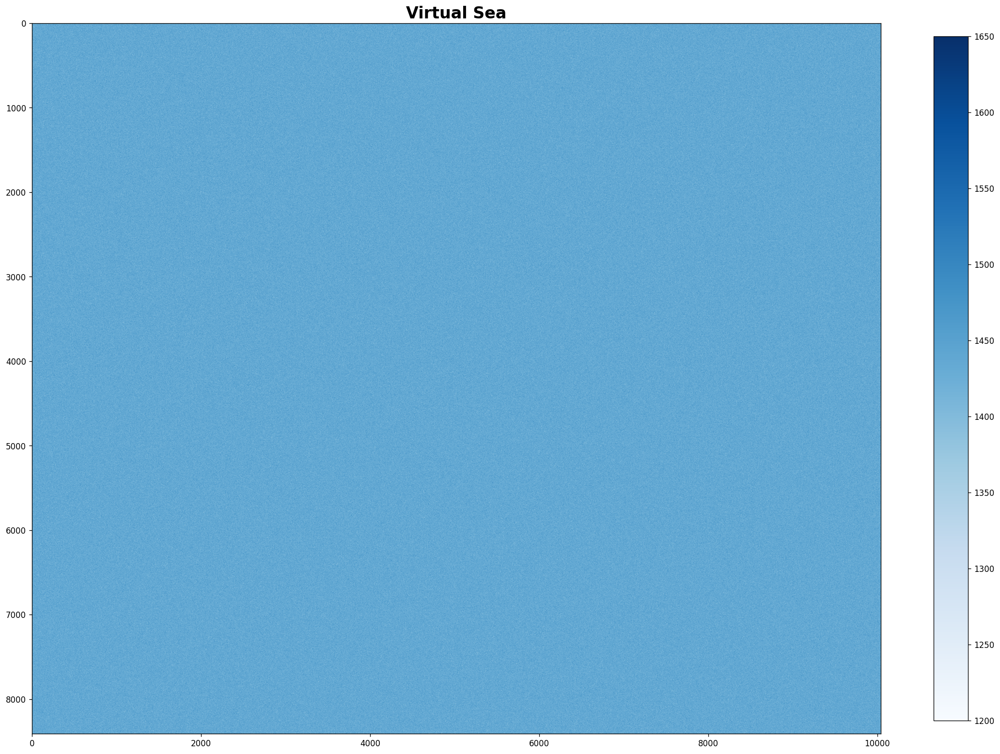

In [13]:
virtual_sea = random.choices(b2_sea_points, k=math.prod(b2.shape))
virtual_sea = np.array(virtual_sea).reshape(b2.shape)

plt.figure(figsize=(19, 16), dpi=120, facecolor='w', edgecolor='k')
plt.title('Virtual Sea', fontsize=20, fontweight='bold')
plt.imshow(virtual_sea, cmap='Blues', vmin=1200., vmax=1650.)
plt.colorbar(shrink=0.75)
plt.tight_layout()
plt.savefig('../output/virtual_sea.png')
plt.show();

plt.clf()
plt.close()


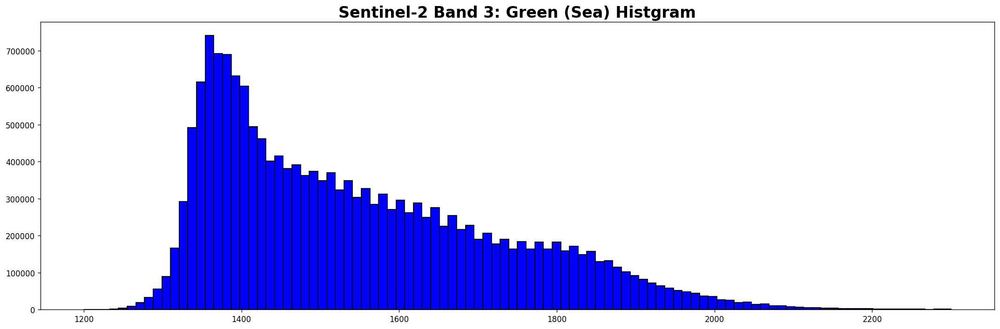

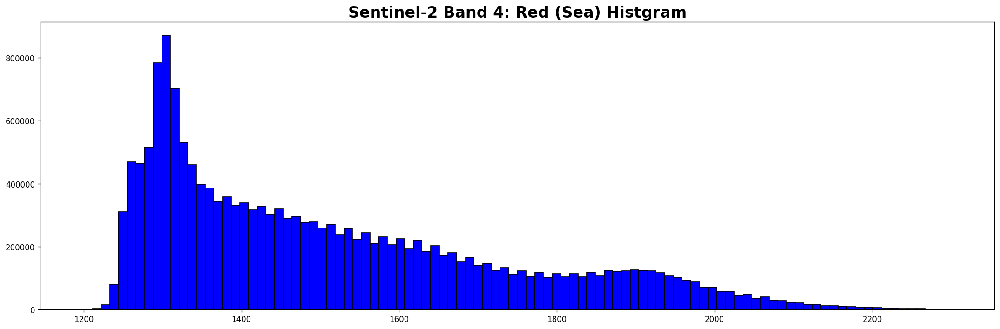

In [14]:
PATH_B3  = '../sample/B03_cut.tif'
b3 = tifffile.imread(PATH_B3)
b3 = b3.astype(np.float32)

b3_sea = np.where(dem == -1, b3, 0)

plt.figure(figsize=(18, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 3: Green (Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(b2_sea[b2_sea > 1].ravel(), bins=100, range=(1200., 2300.), fc='b', ec='k')
plt.tight_layout()
plt.savefig('../output/b3_sea_hist.png')
plt.show();

PATH_B4  = '../sample/B04_cut.tif'
b4 = tifffile.imread(PATH_B4)
b4 = b4.astype(np.float32)

b4_sea = np.where(dem == -1, b4, 0)

plt.figure(figsize=(18, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('Sentinel-2 Band 4: Red (Sea) Histgram', fontsize=20, fontweight='bold')
plt.hist(b4_sea[b4_sea > 1].ravel(), bins=100, range=(1200., 2300.), fc='b', ec='k')
plt.tight_layout()
plt.savefig('../output/b4_sea_hist.png')
plt.show();

In [15]:
b3_sea_points = b3_sea[b3_sea > 1]
b3_sea_points = b3_sea_points[b3_sea_points < 1600]

b4_sea_points = b4_sea[b4_sea > 1]
b4_sea_points = b4_sea_points[b4_sea_points < 1500]

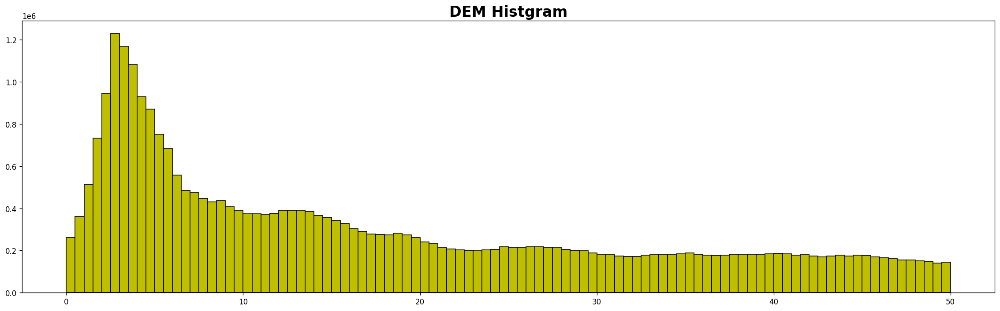

In [16]:
plt.figure(figsize=(19, 6), dpi=120, facecolor='w', edgecolor='k')
plt.title('DEM Histgram', fontsize=20, fontweight='bold')
plt.hist(dem[dem > 0].ravel(), bins=100, range=(0., 50.), fc='y', ec='k')
plt.tight_layout()
plt.savefig('../output/dem_hist.png')
plt.show();

In [17]:
step = 1
depthes = np.arange(0., 40., step=step)
depthes.shape

(40,)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

/tmp/ipykernel_713508/946522445.py:21: DeprecationWarning: <tifffile.imsave> is deprecated. Use tifffile.imwrite
  tifffile.imsave(os.path.join(PATH_DATA, f'flood_{depth:.2f}.tif'), flood)


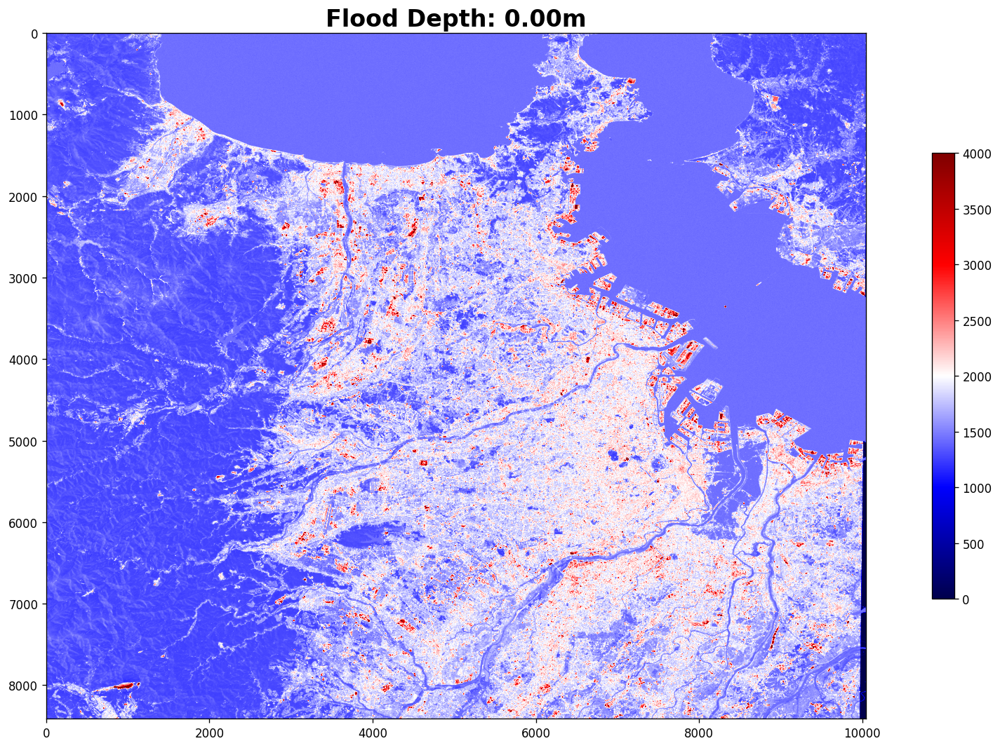

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

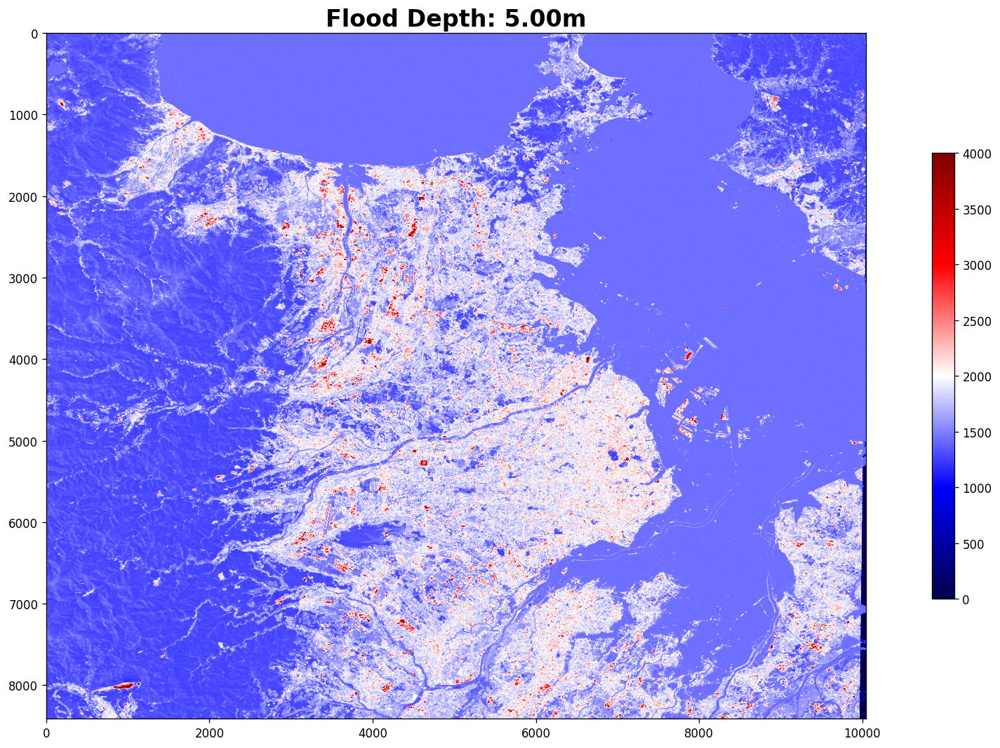

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

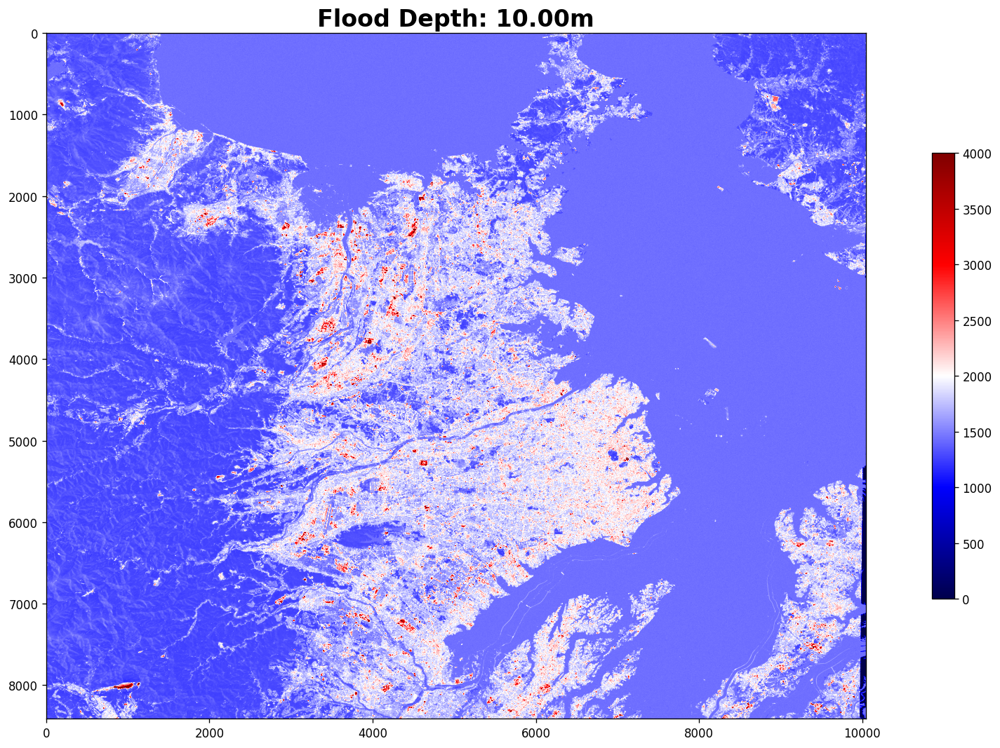

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

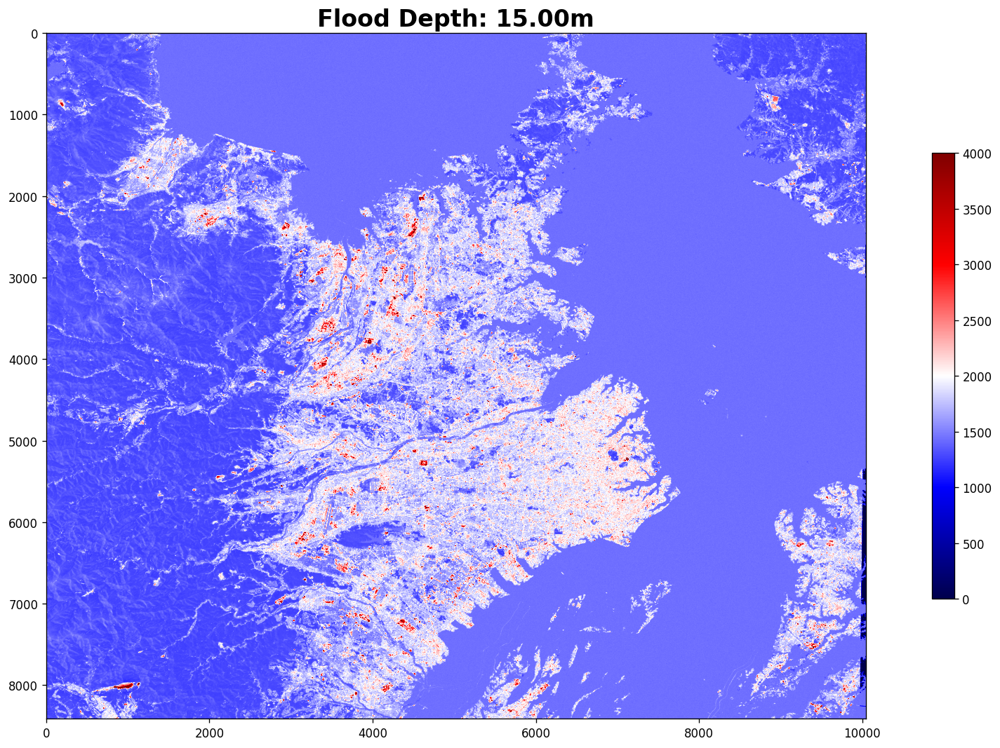

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

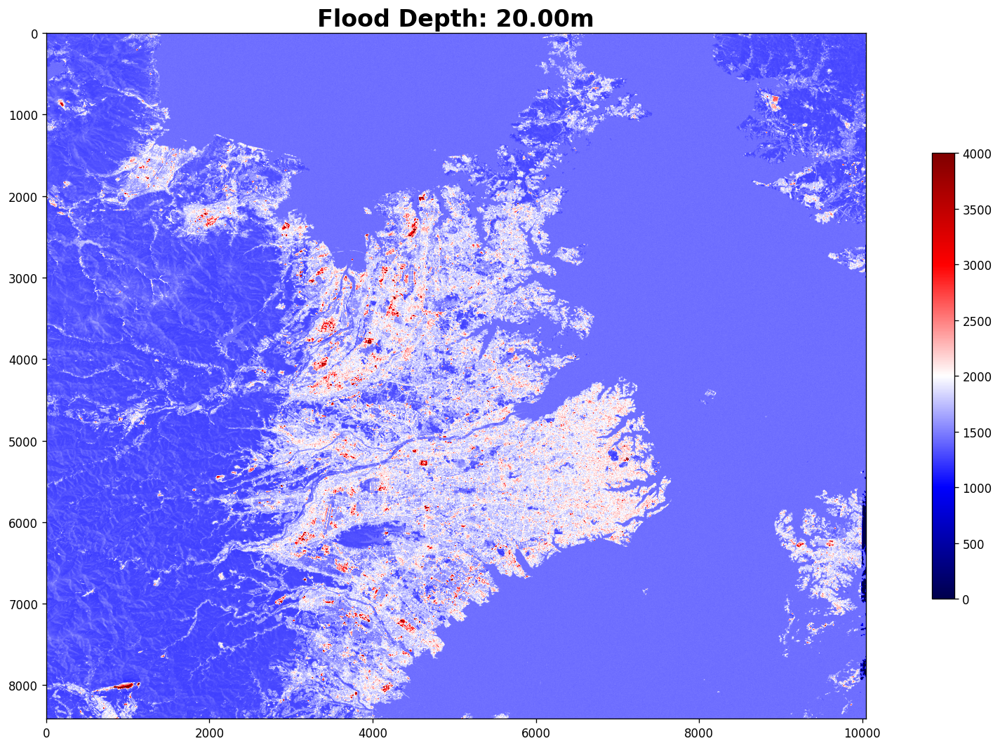

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

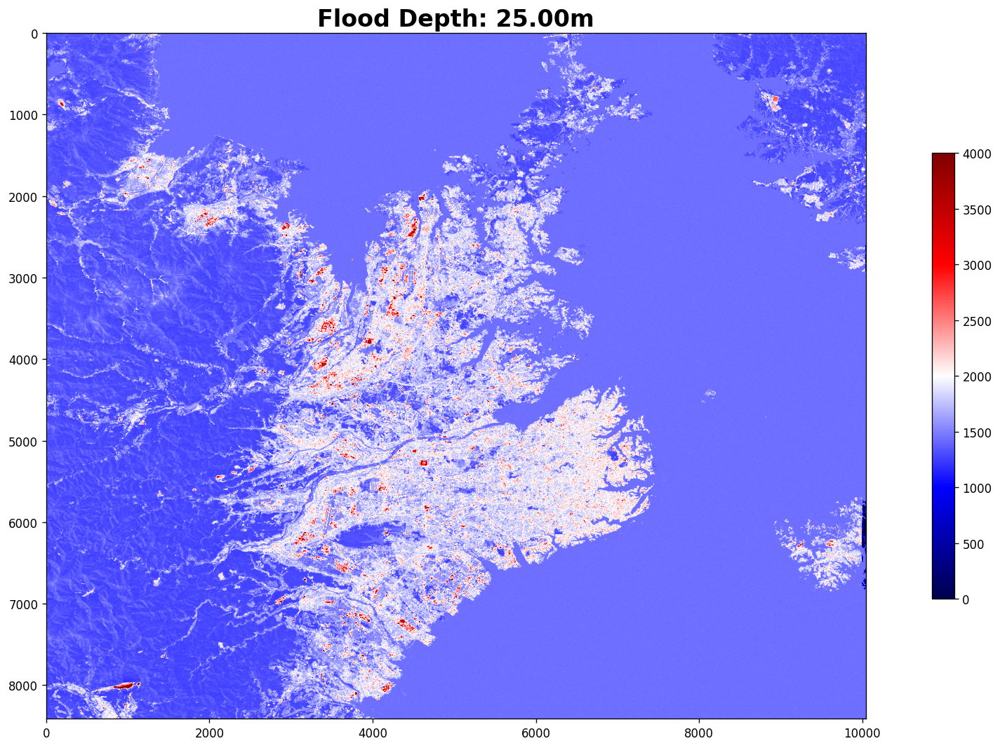

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

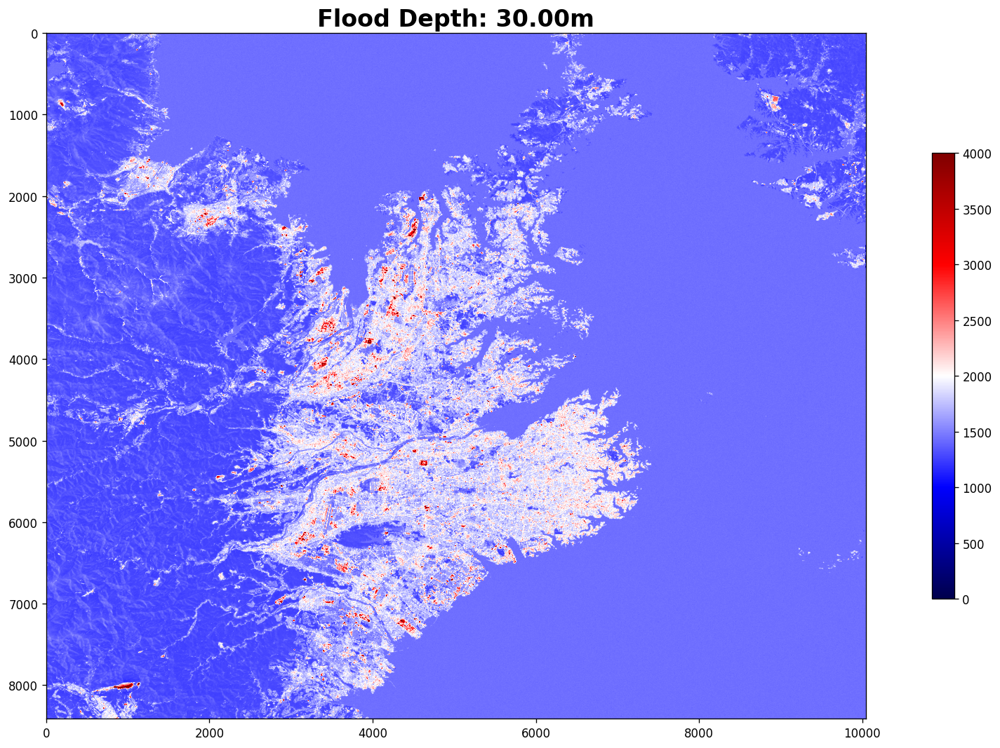

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

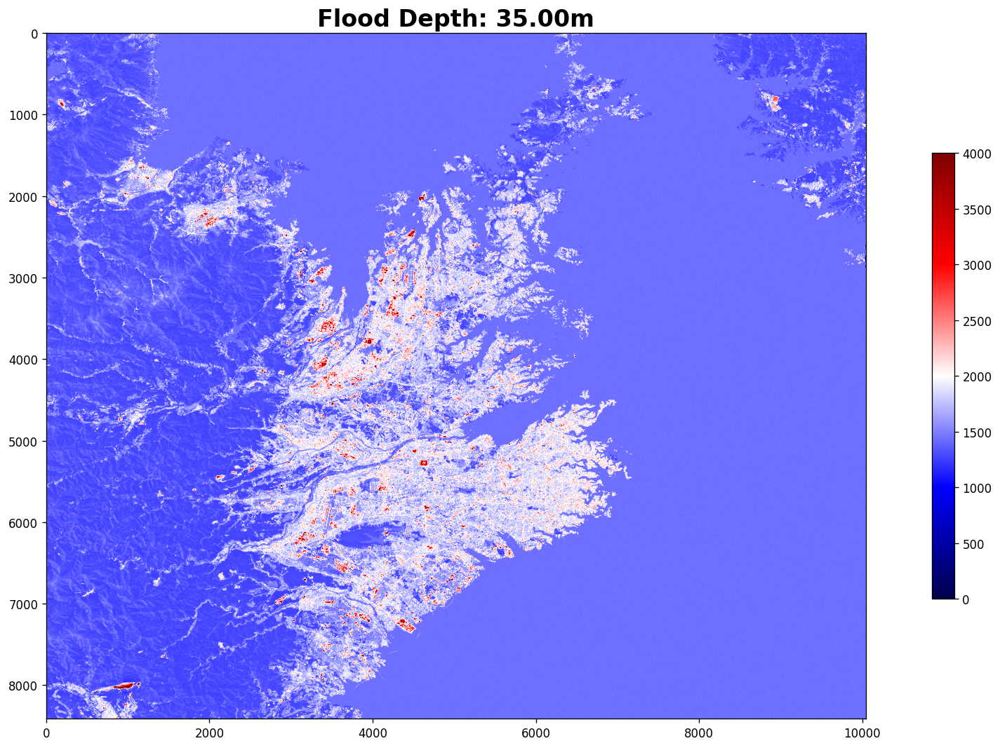

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

In [18]:
PATH_DATA = '../output/virtual_flood/'
os.makedirs(PATH_DATA, exist_ok=True)

for i, depth in tqdm(enumerate(depthes)):
    
    flood_bands = []
    
    for b_sea_points, _b in tqdm(zip([b2_sea_points, b3_sea_points, b4_sea_points], [b2, b3, b4])):
    
        # ramdom virtual sea
        virtual_sea = random.choices(b_sea_points, k=math.prod(_b.shape))
        virtual_sea = np.array(virtual_sea).reshape(_b.shape)
        
        # select flood area from dem
        flood = np.where(dem > depth, _b, virtual_sea)
        flood = flood.astype(np.float32)
        flood_bands.append(flood)
        
    # merge bands
    flood = np.stack(flood_bands, axis=2)
    tifffile.imsave(os.path.join(PATH_DATA, f'flood_{depth:.2f}.tif'), flood)
    
    # plot
    plt.figure(figsize=(16, 9), dpi=120, facecolor='w', edgecolor='k')
    plt.title(f'Flood Depth: {depth:.2f}m', fontsize=20, fontweight='bold')
    plt.imshow(flood[:, :, 0], cmap='seismic', vmin=0., vmax=4000.)
    plt.colorbar(shrink=0.65)
    plt.tight_layout()
    plt.savefig(os.path.join(PATH_DATA, f'flood_{depth:.2f}.png'))
    
    if i % 5 == 0:
        plt.show();
    
    plt.clf()
    plt.close()